In [1]:
using Revise

In [2]:
# Import packages
using
    QuantumStates,
    OpticalBlochEquations,
    DifferentialEquations,
    UnitsToValue,
    LinearAlgebra,
    Plots,
    Random,
    StatsBase,
    StructArrays,
    LoopVectorization,
    Distributions,
    Printf,
    ProgressMeter
;

import MutableNamedTuples: MutableNamedTuple
using Parameters
;

In [3]:
# Define some constants for the simulation
const λ = 626e-9
const Γ = 2π* 6.4e6
const m = @with_unit 57 "u"
const k = 2π / λ
_μB = (μ_B / h) * 1e-4
;

### X state Hamiltonian for CaOH

In [4]:
QN_bounds = (
    S = 1/2, 
    I = 1/2, 
    Λ = 0, 
    N = 0:3
)
X_state_basis = enumerate_states(HundsCaseB_Rot, QN_bounds)

X_state_operator = :(
    BX * Rotation + 
    DX * RotationDistortion + 
    γX * SpinRotation + 
    bFX * Hyperfine_IS + 
    cX * (Hyperfine_Dipolar/3)
)

X_state_parameters = QuantumStates.@params begin
    BX = 10023.0841
    DX = 1.154e-2
    γX = 34.7593
    bFX = 2.602
    cX = 2.053
end

X_state_ham = Hamiltonian(basis=X_state_basis, operator=X_state_operator, parameters=X_state_parameters)

# Add Zeeman terms
Zeeman_x(state, state′) = (Zeeman(state, state′,-1) - Zeeman(state, state′,1))/sqrt(2)
Zeeman_y(state, state′) = im*(Zeeman(state, state′,-1) + Zeeman(state, state′,1))/sqrt(2)
Zeeman_z(state, state′) = Zeeman(state, state′, 0)

X_state_ham = add_to_H(X_state_ham, :B_x, (gS * _μB * 1e-6) * Zeeman_x)
X_state_ham = add_to_H(X_state_ham, :B_y, (gS * _μB * 1e-6) * Zeeman_y)
X_state_ham = add_to_H(X_state_ham, :B_z, (gS * _μB * 1e-6) * Zeeman_z)
X_state_ham.parameters.B_x = 0.
X_state_ham.parameters.B_y = 0.
X_state_ham.parameters.B_z = 0.

evaluate!(X_state_ham)
QuantumStates.solve!(X_state_ham)
;

### A state Hamiltonian for CaOH

In [5]:
QN_bounds = (
    S = 1/2,
    I = 1/2,
    Λ = (-1,1),
    J = 1/2:5/2
)
A_state_basis = enumerate_states(HundsCaseA_Rot, QN_bounds)

A_state_operator = :(
    T_A * DiagonalOperator +
    Be_A * Rotation + 
    Aso_A * SpinOrbit +
    q_A * ΛDoubling_q +
    p_A * ΛDoubling_p2q + q_A * (2ΛDoubling_p2q)
)

# Spectroscopic constants for CaOH, A state
A_state_parameters = QuantumStates.@params begin
    T_A = 15998.122 * 299792458 * 1e-4
    Be_A = 0.3412200 * 299792458 * 1e-4
    Aso_A = 66.8181 * 299792458 * 1e-4
    p_A = -0.04287 * 299792458 * 1e-4
    q_A = -0.3257e-3 * 299792458 * 1e-4
end

A_state_ham = Hamiltonian(basis=A_state_basis, operator=A_state_operator, parameters=A_state_parameters)
evaluate!(A_state_ham)
QuantumStates.solve!(A_state_ham)
;

### Get relevant states and define transition dipole moments

In [6]:
A_state_J12_pos_parity_states = A_state_ham.states[5:8]

QN_bounds = (
    S = 1/2, 
    I = 1/2, 
    Λ = (-1,1), 
    N = 0:3
)
A_state_caseB_basis = enumerate_states(HundsCaseB_Rot, QN_bounds)

ground_states = X_state_ham.states[5:16]
excited_states = convert_basis(A_state_J12_pos_parity_states, A_state_caseB_basis)

states = [ground_states; excited_states]
n_excited = length(excited_states)

for state ∈ states
    state.E *= 1e6
end
;

d = zeros(ComplexF64, 16, 16, 3)
d_ge = zeros(ComplexF64, 12, 4, 3)

basis_tdms = get_tdms_two_bases(X_state_ham.basis, A_state_caseB_basis, TDM)
tdms_between_states!(d_ge, basis_tdms, ground_states, excited_states)
d[1:12, 13:16, :] .= d_ge
;

### Define some functions to be used for the simulation

In [7]:
function randomize_initial_vector!(p, r_dist, v_dist)
    n_excited = extra_p.n_excited
    n_states = length(p.states)
    p.ψ[n_states + n_excited + 1] = rand(r_dist)*k
    p.ψ[n_states + n_excited + 2] = rand(r_dist)*k
    p.ψ[n_states + n_excited + 3] = rand(r_dist)*k
    p.ψ[n_states + n_excited + 4] = rand(v_dist)*k/Γ
    p.ψ[n_states + n_excited + 5] = rand(v_dist)*k/Γ
    p.ψ[n_states + n_excited + 6] = rand(v_dist)*k/Γ
end

function operator_to_matrix(A, states)
    """
    Write an operator as a matrix in basis {states}.
    """
    n_states = length(states)
    A_mat = zeros(ComplexF64, n_states, n_states)
    for i in 1:n_states
        for j in 1:n_states
            A_mat[i,j] = extend_operator(A, states[i], states[j])
        end
    end
    return A_mat
end

function operator_to_matrix_zero_padding2(OA, A_states, B_states)
    """
    OA is an operator on Hilbert space A (basis = A_states).
    We would like to extend A to the direct-sum space A ⨁ B by padding with zeros, i.e.
    <i|OAB|j> = 0 if i∉A or j∉A, <i|OAB|j> = <i|OA|j> if i∈A and j∈A.
    """
    n_A = length(A_states)
    n_B = length(B_states)
    OAB_mat = zeros(ComplexF64, n_A+n_B, n_A+n_B)
    OAB_mat[1:n_A, 1:n_A] .= operator_to_matrix(OA, A_states)
    return OAB_mat
end

function init_isotropic_MOT_distribution(T, diameter)
    kB = 1.381e-23
    m = @with_unit 57 "u"
    σ = sqrt(kB * T / m)
    
    r = Normal(0, diameter)
    v = Normal(0, σ)
    return r, v
end

function init_MOT_distribution(T, diameter,displacement,kick)
    kB = 1.381e-23
    m = @with_unit 57 "u"
    σ = sqrt(kB * T / m)
    
    r = Normal(displacement, diameter)
    v = Normal(kick, σ)
    return r, v
end

function randomize_initial_vector!(p, x_dist, y_dist, z_dist, vx_dist, vy_dist, vz_dist)
    n_excited = extra_p.n_excited
    n_states = length(p.states)
    p.ψ[n_states + n_excited + 1] = rand(x_dist)*k
    p.ψ[n_states + n_excited + 2] = rand(y_dist)*k
    p.ψ[n_states + n_excited + 3] = rand(z_dist)*k
    p.ψ[n_states + n_excited + 4] = rand(vx_dist)*k/Γ
    p.ψ[n_states + n_excited + 5] = rand(vy_dist)*k/Γ
    p.ψ[n_states + n_excited + 6] = rand(vz_dist)*k/Γ
end

function fixed_initial_vector!(p, x, y, z, vx, vy, vz)
     n_excited = extra_p.n_excited
    n_states = length(p.states)
    p.ψ[n_states + n_excited + 1] = x*k
    p.ψ[n_states + n_excited + 2] = y*k
    p.ψ[n_states + n_excited + 3] = z*k
    p.ψ[n_states + n_excited + 4] = vx*k/Γ
    p.ψ[n_states + n_excited + 5] = vy*k/Γ
    p.ψ[n_states + n_excited + 6] = vz*k/Γ
end

function random_initial_state!(p)
    n_excited = extra_p.n_excited
    n_states = length(p.states)
   rn = rand() * (n_states - n_excited)
    i = Int(floor(rn))+1
    p.ψ[1:n_states].=0.0
    p.ψ[i] = 1.0
end
;

In [8]:
# Define Zeeman Hamiltonians for B-fields along x, y, and z
Zeeman_x(state, state′) = (Zeeman(state, state′,-1) - Zeeman(state, state′,1))/sqrt(2)
Zeeman_y(state, state′) = im*(Zeeman(state, state′,-1) + Zeeman(state, state′,1))/sqrt(2)
Zeeman_z(state, state′) = Zeeman(state, state′, 0)

Zeeman_x_mat = StructArray(operator_to_matrix_zero_padding2(Zeeman_x, ground_states, excited_states) .* (2π*gS*_μB/Γ))
Zeeman_y_mat = StructArray(operator_to_matrix_zero_padding2(Zeeman_y, ground_states, excited_states) .* (2π*gS*_μB/Γ))
Zeeman_z_mat = StructArray(operator_to_matrix_zero_padding2(Zeeman_z, ground_states, excited_states) .* (2π*gS*_μB/Γ))
;

### Define function that updates the Hamiltonian at each time step throughout the simulation

In [9]:
# `update_H` is passed to the simulation and can be used to add terms to the Hamiltonian that are time-dependent
# Here we use `update_H` to include a quadrupole magnetic field for molecules in a magneto-optical trap
function update_H(H, p, r, τ)
    Zeeman_Hz = p.extra_p.Zeeman_Hz
    Zeeman_Hx = p.extra_p.Zeeman_Hx
    Zeeman_Hy = p.extra_p.Zeeman_Hy
    
    # ramp the magnetic field, exponential
    # τ_bfield = p.extra_p.ramp_time / (1/Γ)
    # denom = 1/(exp(1)-1)
    # scalar = denom * exp(τ/τ_bfield) - denom
    # scalar = min(scalar, 1.0)
    
    # ramp the magnetic field, linear
    τ_bfield = p.extra_p.ramp_time / (1/Γ)
    scalar = τ/τ_bfield
    scalar = min(scalar, 1.0)
    
    gradient_z = scalar * p.extra_p.gradient_z
    gradient_x = scalar * p.extra_p.gradient_x
    gradient_y = scalar * p.extra_p.gradient_y
    @turbo for i in eachindex(H)
        H.re[i] = gradient_z * Zeeman_Hz.re[i] * r[3] + gradient_x * Zeeman_Hx.re[i] * r[1] + gradient_y * Zeeman_Hy.re[i] * r[2]
        H.im[i] = gradient_z * Zeeman_Hz.im[i] * r[3] + gradient_x * Zeeman_Hx.im[i] * r[1] + gradient_y * Zeeman_Hy.im[i] * r[2]
        # H.re[i] = gradient_z * Zeeman_Hz.re[i] + gradient_x * Zeeman_Hx.re[i]
        # H.im[i] = gradient_z * Zeeman_Hz.im[i] + gradient_x * Zeeman_Hx.im[i]
    end

    # Ramp the detuning; might work with 2 frequencies?
    # p.fields.
    
    return nothing
end
;

In [184]:
function ramp_scalar(t, s_end, ramp_time)
    τ = ramp_time / (1/Γ)
    scalar = exp(-t/τ)
    return max(scalar, s_end)
end

function gaussian_intensity_along_axes(r, axes, centers)
    d2 = (r[axes[1]] - centers[1])^2 + (r[axes[2]] - centers[2])^2   
    return exp(-2*d2/(5e-3/(1/k))^2)
end

# Define a function to initialize the lasers that we use for the simulation
function initialize_lasers(states)

    x_center_y = 2e-3 / (1/k)
    x_center_z = 0.
    y_center_x = 2e-3 / (1/k)
    y_center_z = 0.
    z_center_x = 2e-3 / (1/k)
    z_center_y = 0.
    
    s_ramp_time = 30e-3
    final_intensity = 1.0
    s_gaussian(s, axes, centers) = (r,t) -> s * gaussian_intensity_along_axes(r, axes, centers) #* ramp_scalar(t, final_intensity, s_ramp_time)
    
    flip(ϵ) = (ϵ == σ⁻) ? σ⁺ : σ⁻
    
    # 3 frequencies for experiment, close to best
    s1 = 2.0
    s2 = 0.0
    s3 = 2.0
    s4 = 4.0
    Δ1 = +1.8Γ #+ 1.0Γ
    Δ2 = 0.0Γ
    Δ3 = +1.8Γ #+ 1.0Γ
    Δ4 = -2.9Γ #+ 1.0Γ
    pol1 = σ⁻ # is + polarization better?
    pol2 = σ⁺
    pol3 = σ⁺
    pol4 = σ⁻
    # s1 = 2.0
    # s2 = 0.0
    # s3 = 2.0
    # s4 = 2.0
    # Δ1 = +3.0Γ
    # Δ2 = 0.0Γ
    # Δ3 = +3.0Γ
    # Δ4 = -3.0Γ
    # pol1 = σ⁻
    # pol2 = σ⁺
    # pol3 = σ⁺
    # pol4 = σ⁻
    # s1 = 2.00
    # s2 = 0.00
    # s3 = 1.50
    # s4 = 5.00
    # Δ1 = 2.44Γ
    # Δ2 = 0.0Γ
    # Δ3 = 2.44Γ
    # Δ4 = -4.00Γ
    # pol1 = σ⁻
    # pol2 = σ⁺
    # pol3 = σ⁺
    # pol4 = σ⁻
    
    # 3 frequencies, weird polarization, works well!
    # s1 = 1.0
    # s2 = 0.0
    # s3 = 1.0
    # s4 = 2.0
    # Δ1 = +2.0Γ
    # Δ2 = 0.0Γ
    # Δ3 = +2.0Γ
    # Δ4 = -1.5Γ
    # pol1 = σ⁺ # is + polarization better?
    # pol2 = σ⁺
    # pol3 = σ⁺
    # pol4 = σ⁻

    # 3 frequencies, weird polarization, seems even better
    # s1 = 2.0
    # s2 = 0.0
    # s3 = 2.0
    # s4 = 3.0
    # Δ1 = +2.5Γ
    # Δ2 = 0.0Γ
    # Δ3 = +2.5Γ
    # Δ4 = -3.0Γ
    # pol1 = σ⁺ # is + polarization better?
    # pol2 = σ⁺
    # pol3 = σ⁺
    # pol4 = σ⁻
    
    # opposite polarization, works well
    # s1 = 1.50
    # s2 = 1.00
    # s3 = 1.50
    # s4 = 0.00
    # Δ1 = +2.50Γ
    # Δ2 = -3.00Γ
    # Δ3 = +2.50Γ
    # Δ4 = -0.00Γ
    # pol1 = σ⁺
    # pol2 = σ⁻
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # 4 frequencies
    # s1 = 2.00
    # s2 = 0.50
    # s3 = 2.00
    # s4 = 0.50
    # Δ1 = +1.00Γ
    # Δ2 = -2.00Γ
    # Δ3 = +2.00Γ
    # Δ4 = -2.00Γ
    # pol1 = σ⁻
    # pol2 = σ⁺
    # pol3 = σ⁺
    # pol4 = σ⁻
    # s1 = 3.00
    # s2 = 1.00
    # s3 = 3.00
    # s4 = 1.00
    # Δ1 = +3.00Γ
    # Δ2 = -2.00Γ
    # Δ3 = +2.00Γ
    # Δ4 = -2.00Γ
    # pol1 = σ⁻
    # pol2 = σ⁻
    # pol3 = σ⁺
    # pol4 = σ⁺
    
    # 40 G/cm
    # s1 = 1.00
    # s2 = 0.25
    # s3 = 1.00
    # s4 = 0.25
    # Δ1 = +1.00Γ
    # Δ2 = -1.50Γ
    # Δ3 = +1.00Γ
    # Δ4 = -1.50Γ
    # pol1 = σ⁻
    # pol2 = σ⁻
    # pol3 = σ⁺
    # pol4 = σ⁺
    
    # 4 frequencies, works well
    # s1 = 2.00*2
    # s2 = 0.50*2
    # s3 = 2.00*2
    # s4 = 0.50*2
    # Δ1 = +2.00Γ
    # Δ2 = -2.00Γ
    # Δ3 = +2.00Γ
    # Δ4 = -2.00Γ
    # pol1 = σ⁻
    # pol2 = σ⁻
    # pol3 = σ⁺
    # pol4 = σ⁺
    
    # s1 = 3.00
    # s2 = 1.00
    # s3 = 3.00
    # s4 = 1.00
    # Δ1 = +1.00Γ
    # Δ2 = -2.00Γ
    # Δ3 = +1.00Γ
    # Δ4 = -2.00Γ
    # pol1 = σ⁻
    # pol2 = σ⁻
    # pol3 = σ⁺
    # pol4 = σ⁺
    
    # even weirder polarizations
    # s1 = 4.00
    # s2 = 1.00
    # s3 = 4.00
    # s4 = 2.00
    # Δ1 = +2.00Γ
    # Δ2 = -3.00Γ
    # Δ3 = +2.00Γ
    # Δ4 = -7.00Γ
    # pol1 = σ⁺
    # pol2 = σ⁺
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # works best, can ramp to 45 G/cm
    # s1 = 2.00
    # s2 = 1.00
    # s3 = 6.00 # can lower a bit for lower scattering rate, but also starts to lose a few molecules
    # s4 = 2.00
    # Δ1 = +2.00Γ # smaller detuning gives smaller cloud (and colder?) but smaller capture range
    # Δ2 = -4.00Γ
    # Δ3 = +2.00Γ
    # Δ4 = -7.00Γ
    # pol1 = σ⁺
    # pol2 = σ⁺
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # works better?
    # s1 = 2.00
    # s2 = 0.75
    # s3 = 6.00
    # s4 = 3.00
    # Δ1 = +2.00Γ
    # Δ2 = -2.00Γ
    # Δ3 = +2.00Γ
    # Δ4 = -7.00Γ
    # pol1 = σ⁺
    # pol2 = σ⁺
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # lower scattering rate, not as small
    # s1 = 3.00
    # s2 = 0.30
    # s3 = 6.00
    # s4 = 2.50
    # Δ1 = +2.25Γ
    # Δ2 = -2.00Γ
    # Δ3 = +2.25Γ
    # Δ4 = -7.00Γ
    # pol1 = σ⁺
    # pol2 = σ⁺
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # works better???
    # s1 = 2.00
    # s2 = 0.75
    # s3 = 6.00
    # s4 = 3.00
    # Δ1 = +2.00Γ
    # Δ2 = -3.00Γ
    # Δ3 = +2.00Γ
    # Δ4 = -7.00Γ
    # pol1 = σ⁺
    # pol2 = σ⁺
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # Bayesian optimization, 4 frequencies, weirder polarizations
    # s1 = 1.22
    # s2 = 0.1
    # s3 = 4.0
    # s4 = 2.6
    # Δ1 = 2.06
    # Δ2 = -1.62
    # Δ3 = 1.90
    # Δ4 = -6.87
    # pol1 = σ⁺
    # pol2 = σ⁺
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # s1 = 3.00/1.5
    # s2 = 0.00
    # s3 = 5.06/1.5
    # s4 = 4.45/1.5
    # Δ1 = +2.41Γ
    # Δ2 = -2.30Γ
    # Δ3 = +2.41Γ
    # Δ4 = -6.53Γ
    # pol1 = σ⁻
    # pol2 = σ⁺
    # pol3 = σ⁺
    # pol4 = σ⁻
    
#     s1 = 3.37
#     s2 = 0.00
#     s3 = 0.00
#     s4 = 2.39
#     Δ1 = +2.39Γ
#     Δ2 = -2.30Γ
#     Δ3 = +2.39Γ
#     Δ4 = -9.89Γ
#     pol1 = σ⁻
#     pol2 = σ⁺
#     pol3 = σ⁺
#     pol4 = σ⁻
    
#   3.3713569787655207
#   3.0
#   2.389184444900945
#   3.2979906094010407
#  -9.897646967589727
    
    # 30 G/cm optimum
    # s1 = 2.17
    # s2 = 0.00
    # s3 = 3.79
    # s4 = 1.60
    # Δ1 = +3.59Γ
    # Δ2 = -2.30Γ
    # Δ3 = +3.59Γ
    # Δ4 = -5.11Γ
    # pol1 = σ⁻
    # pol2 = σ⁻
    # pol3 = σ⁺
    # pol4 = σ⁻
    
    # s1 = 3.00
    # s2 = 0.00
    # s3 = 5.06
    # s4 = 0.00
    # Δ1 = +2.41Γ
    # Δ2 = -2.30Γ
    # Δ3 = +2.41Γ
    # Δ4 = -6.53Γ
    # pol1 = σ⁻
    # pol2 = σ⁻
    # pol3 = σ⁺
    # pol4 = σ⁻
    
    # bayesian, opserved optimum
 #  2.7347262659397127
 #  3.558534809551924
 #  5.632241880314729
 #  1.9634993886439336
 # -6.834002114447709

# s1 = 3.73; s3 = 6.20; s4 = 3.97; Δ1 = 3.73 Γ; Δ3 = Δ1; Δ4 = -5.41 Γ # different optimum
    
    # alternate 3 frequencies
    # s1 = 10.0
    # s2 = 3.0
    # s3 = 2.0
    # Δ1 = 3.0Γ
    # Δ2 = 3.0Γ #- 2π * 6.75e6
    # Δ3 = -3.0Γ
    # pol1 = sqrt(1-polarization_impurity)*σ⁻ + sqrt(polarization_impurity)*σ⁺
    # pol2 = sqrt(1-polarization_impurity)*σ⁺ + sqrt(polarization_impurity)*σ⁻
    # pol3 = sqrt(1-polarization_impurity)*σ⁻ + sqrt(polarization_impurity)*σ⁺
    # pol1 /= norm(pol1)
    # pol2 /= norm(pol2)
    # pol3 /= norm(pol3)
    # s1_retro = s1
    # s2_retro = s2
    # s3_retro = s3
    
    # now best, with B field of 100 G/cm
    # _s1 = 3.0
    # _s2 = 0.0
    # _s3 = 2.0
    # s1 = s_ramp(_s1)
    # s1_retro = s_ramp(_s1*(1+imbalance))
    # s2 = s_ramp(_s2)
    # s2_retro = s_ramp(_s2*(1+imbalance))
    # s3 = s_ramp(_s3)
    # s3_retro = s_ramp(_s3*(1+imbalance))
    # Δ1 = +4.0Γ
    # Δ2 = -4.0Γ
    # Δ3 = +4.0Γ

    # params = deserialize("CaOH_scan//scan7//examples//test1//params.jl")
    # s1 = params.s1
    # s1_retro = s1*(1+imbalance)
    # s2 = params.s2
    # s2_retro = s2*(1+imbalance)
    # s3 = params.s4
    # s3_retro = s3*(1+imbalance)
    # Δ1 = params.Δ1
    # Δ2 = params.Δ2
    # Δ3 = params.Δ4
    
    # 2 frequencies only
    # s1 = 3.00
    # s2 = 0.00
    # s3 = 6.00
    # s4 = 0.00
    # Δ1 = +2.50Γ
    # Δ2 = -0.00Γ
    # Δ3 = +2.50Γ
    # Δ4 = -1.50Γ
    # pol1 = σ⁻
    # pol2 = σ⁻
    # pol3 = σ⁺
    # pol4 = σ⁺
    
    #######
    # pol1 = σ⁺ #+ polarization_impurity*σ⁺
    # pol2 = σ⁺ #+ polarization_impurity*σ⁺
    # pol3 = σ⁺ #+ polarization_impurity*σ⁻
    # pol4 = σ⁻ #+ polarization_impurity*σ⁻
    # s1 = 2.0
    # s2 = 16.0
    # s3 = 0.0
    # s4 = 6.0
    # Δ1 = +1.0Γ
    # Δ2 = +3.0Γ
    # Δ3 = +0.0Γ
    # Δ4 = -1.5Γ
    
    # pol1 = σ⁺ #+ polarization_impurity*σ⁺
    # pol2 = σ⁻ #+ polarization_impurity*σ⁻
    # pol3 = σ⁺ #+ polarization_impurity*σ⁻
    # pol4 = σ⁺ #+ polarization_impurity*σ⁺
    # s1 = 1.0
    # s2 = 3.0
    # s3 = 4.0
    # s4 = 0.0
    # Δ1 = +1.0Γ
    # Δ2 = -1.5Γ
    # Δ3 = +3.0Γ
    # Δ4 = -0.0Γ
    #######
    
    # Bayesian for 2 frequencies    
    # _s1 = 2.0
    # _s2 = 0.0
    # _s3 = 1.0
    # s1 = s_ramp(_s1)
    # s1_retro = s_ramp(_s1*(1+imbalance))
    # s2 = s_ramp(_s2)
    # s2_retro = s_ramp(_s2*(1+imbalance))
    # s3 = s_ramp(_s3)
    # s3_retro = s_ramp(_s3*(1+imbalance))
    # Δ1 = +2.7064239861691806Γ
    # Δ2 = -3.0Γ
    # Δ3 = +2.9080807644747644Γ

    # kinda works
    # s1 = 0.50
    # s2 = 0*0.25
    # s3 = 1.25
    # s4 = 0.75
    # Δ1 = +1.00Γ
    # Δ2 = -1.50Γ
    # Δ3 = +1.00Γ
    # Δ4 = -1.50Γ
    # pol1 = σ⁺
    # pol2 = σ⁻
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # works better?
    # s1 = 1.00
    # s2 = 0*0.25
    # s3 = 1.00*2
    # s4 = 0.75*2
    # Δ1 = +1.00Γ
    # Δ2 = -1.50Γ
    # Δ3 = +1.00Γ
    # Δ4 = -2.00Γ
    # pol1 = σ⁺
    # pol2 = σ⁻
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # works best?
    # s1 = 1.00
    # s2 = 0*0.25
    # s3 = 1.00*2
    # s4 = 0.75*5
    # Δ1 = +1.00Γ
    # Δ2 = -1.50Γ
    # Δ3 = +1.00Γ
    # Δ4 = -4.00Γ
    # pol1 = σ⁺
    # pol2 = σ⁻
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # s1 = 1.00*1.5
    # s2 = 0*0.25
    # s3 = 2.00*1.5
    # s4 = 5.50
    # Δ1 = +1.00Γ
    # Δ2 = -1.50Γ
    # Δ3 = +1.00Γ
    # Δ4 = -8.00Γ
    # pol1 = σ⁺
    # pol2 = σ⁻
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # s1 = 1.00#*2
    # s2 = 0.25#*2
    # s3 = 2.00#*2
    # s4 = 0.50#*2
    # Δ1 = +1.25Γ
    # Δ2 = -2.00Γ
    # Δ3 = +1.25Γ
    # Δ4 = -2.00Γ
    # pol1 = σ⁺
    # pol2 = σ⁻
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # s1 = 2.60
    # s2 = 0.00
    # s3 = 0*2.60
    # s4 = 6.83
    # Δ1 = +2.61Γ
    # Δ2 = -3.00Γ
    # Δ3 = +2.61Γ
    # Δ4 = -9.50Γ
    # pol1 = σ⁺
    # pol2 = σ⁻
    # pol3 = σ⁻
    # pol4 = σ⁺
    
    # works well, seems optimal (?), 11/11
    # s1 = 3.00 #1.47
    # s2 = 0.00 # but can be 0
    # s3 = 5.06
    # s4 = 4.45
    # Δ1 = +2.41Γ
    # Δ2 = -2.30Γ
    # Δ3 = +2.41Γ
    # Δ4 = -6.53Γ
    # pol1 = σ⁻
    # pol2 = σ⁻
    # pol3 = σ⁺
    # pol4 = σ⁻
    
    # Bayesian optimum, 11/11, 9:42am
    s1 = 2.9525082413112442
    s2 = 0.00
    s3 = 1.6509590867606776
    s4 = 4.738939337340759
    Δ1 = +3.7291212568408656Γ
    Δ2 = -2.30Γ
    Δ3 = +3.7291212568408656Γ
    Δ4 = -8.0Γ
    pol1 = σ⁻
    pol2 = σ⁺
    pol3 = σ⁺
    pol4 = σ⁻
    
    ω1 = 2π * (energy(states[end]) - energy(states[1])) + Δ1 # J=1/2 blue
    ω2 = 2π * (energy(states[end]) - energy(states[1])) + Δ2 # J=1/2 red
    ω3 = 2π * (energy(states[end]) - energy(states[5])) + Δ3 # J=3/2 blue
    ω4 = 2π * (energy(states[end]) - energy(states[5])) + Δ4 # J=3/2 red
    
    # ϵ_(ϵ, f) = t -> exp(-im*2π*f*t/5000) .* ϵ
    ϵ_(ϵ, f) = t -> ϵ

    Φ1 = exp(im*2π*rand())
    Φ2 = exp(im*2π*rand())
    Φ3 = exp(im*2π*rand())
    Φ4 = exp(im*2π*rand())
    Φ5 = exp(im*2π*rand())
    Φ6 = exp(im*2π*rand())
    
    # beam_misalignment = 0.03
    # k̂1 = +x̂
    # k̂2 = -(1-beam_misalignment)*x̂ + beam_misalignment*ŷ
    # k̂3 = +ŷ
    # k̂4 = -(1-beam_misalignment)*ŷ + beam_misalignment*ẑ
    # k̂5 = +ẑ
    # k̂6 = -(1-beam_misalignment)*ẑ + beam_misalignment*x̂
    
    x_beam_misalignment = 0.0
    k̂1 = +(1-x_beam_misalignment)*x̂ - x_beam_misalignment*ŷ
    k̂2 = -(1-x_beam_misalignment)*x̂ + x_beam_misalignment*ŷ
    k̂3 = +ŷ
    k̂4 = -ŷ
    k̂5 = +ẑ
    k̂6 = -ẑ
    
    x_beam_polarization_impurity_1 = 0.05
    y_beam_polarization_impurity_1 = 0.05
    z_beam_polarization_impurity_1 = 0.05
    x_beam_polarization_impurity_2 = 0.05
    y_beam_polarization_impurity_2 = 0.05
    z_beam_polarization_impurity_2 = 0.05
    x_beam_polarization_impurity_3 = 0.05
    y_beam_polarization_impurity_3 = 0.05
    z_beam_polarization_impurity_3 = 0.05
    x_beam_polarization_impurity_4 = 0.05
    y_beam_polarization_impurity_4 = 0.05
    z_beam_polarization_impurity_4 = 0.05
    pol1_x = sqrt(1 - x_beam_polarization_impurity_1)*pol1 + sqrt(x_beam_polarization_impurity_1)*flip(pol1)
    pol2_x = sqrt(1 - x_beam_polarization_impurity_2)*pol2 + sqrt(x_beam_polarization_impurity_2)*flip(pol2)
    pol3_x = sqrt(1 - x_beam_polarization_impurity_3)*pol3 + sqrt(x_beam_polarization_impurity_3)*flip(pol3)
    pol4_x = sqrt(1 - x_beam_polarization_impurity_4)*pol4 + sqrt(x_beam_polarization_impurity_4)*flip(pol4)
    pol1_y = sqrt(1 - y_beam_polarization_impurity_1)*pol1 + sqrt(y_beam_polarization_impurity_1)*flip(pol1)
    pol2_y = sqrt(1 - y_beam_polarization_impurity_2)*pol2 + sqrt(y_beam_polarization_impurity_2)*flip(pol2)
    pol3_y = sqrt(1 - y_beam_polarization_impurity_3)*pol3 + sqrt(y_beam_polarization_impurity_3)*flip(pol3)
    pol4_y = sqrt(1 - y_beam_polarization_impurity_4)*pol4 + sqrt(y_beam_polarization_impurity_4)*flip(pol4)
    pol1_z = sqrt(1 - z_beam_polarization_impurity_1)*flip(pol1) + sqrt(z_beam_polarization_impurity_1)*pol1
    pol2_z = sqrt(1 - z_beam_polarization_impurity_2)*flip(pol2) + sqrt(z_beam_polarization_impurity_2)*pol2
    pol3_z = sqrt(1 - z_beam_polarization_impurity_3)*flip(pol3) + sqrt(z_beam_polarization_impurity_3)*pol3
    pol4_z = sqrt(1 - z_beam_polarization_impurity_4)*flip(pol4) + sqrt(z_beam_polarization_impurity_4)*pol4
    
    imbalance = 0.10
    s1_retro = s1*(1-imbalance)
    s2_retro = s2*(1-imbalance)
    s3_retro = s3*(1-imbalance)
    s4_retro = s4*(1-imbalance)
    
    # create beams that are slightly misaligned with each other
    ϵ1 = Φ1 .* rotate_pol(pol1_x, k̂1); ϵ_func1 = ϵ_(ϵ1, 1); laser1 = Field(k̂1, ϵ_func1, ω1, s_gaussian(s1,  (2,3), (x_center_y, x_center_z)))
    ϵ2 = Φ2 .* rotate_pol(pol1_x, k̂2); ϵ_func2 = ϵ_(ϵ2, 2); laser2 = Field(k̂2, ϵ_func2, ω1, s_gaussian(s1_retro, (2,3), (x_center_y, x_center_z)))
    ϵ3 = Φ3 .* rotate_pol(pol1_y, k̂3); ϵ_func3 = ϵ_(ϵ3, 3); laser3 = Field(k̂3, ϵ_func3, ω1, s_gaussian(s1, (1,3), (y_center_x, y_center_z)))
    ϵ4 = Φ4 .* rotate_pol(pol1_y, k̂4); ϵ_func4 = ϵ_(ϵ4, 4); laser4 = Field(k̂4, ϵ_func4, ω1, s_gaussian(s1_retro, (1,3), (y_center_x, y_center_z)))
    ϵ5 = Φ5 .* rotate_pol(pol1_z, k̂5); ϵ_func5 = ϵ_(ϵ5, 5); laser5 = Field(k̂5, ϵ_func5, ω1, s_gaussian(s1, (1,2), (z_center_x, z_center_y)))
    ϵ6 = Φ6 .* rotate_pol(pol1_z, k̂6); ϵ_func6 = ϵ_(ϵ6, 6); laser6 = Field(k̂6, ϵ_func6, ω1, s_gaussian(s1_retro, (1,2), (z_center_x, z_center_y)))

    lasers_1 = [laser1, laser2, laser3, laser4, laser5, laser6]

    ϵ7 = Φ1 .* rotate_pol(pol2_x, k̂1); ϵ_func7 = ϵ_(ϵ7, 1); laser7 = Field(k̂1, ϵ_func7, ω2, s_gaussian(s2, (2,3), (x_center_y, x_center_z)))
    ϵ8 = Φ2 .* rotate_pol(pol2_x, k̂2); ϵ_func8 = ϵ_(ϵ8, 2); laser8 = Field(k̂2, ϵ_func8, ω2, s_gaussian(s2_retro, (2,3), (x_center_y, x_center_z)))
    ϵ9 = Φ3 .* rotate_pol(pol2_y, k̂3); ϵ_func9 = ϵ_(ϵ9, 3); laser9 = Field(k̂3, ϵ_func9, ω2, s_gaussian(s2, (1,3), (y_center_x, y_center_z)))
    ϵ10 = Φ4 .* rotate_pol(pol2_y, k̂4); ϵ_func10 = ϵ_(ϵ10, 4); laser10 = Field(k̂4, ϵ_func10, ω2, s_gaussian(s2_retro, (1,3), (y_center_x, y_center_z)))
    ϵ11 = Φ5 .* rotate_pol(pol2_z, k̂5); ϵ_func11 = ϵ_(ϵ11, 5); laser11 = Field(k̂5, ϵ_func11, ω2, s_gaussian(s2, (1,2), (z_center_x, z_center_y)))
    ϵ12 = Φ6 .* rotate_pol(pol2_z, k̂6); ϵ_func12 = ϵ_(ϵ12, 6); laser12 = Field(k̂6, ϵ_func12, ω2, s_gaussian(s2_retro, (1,2), (z_center_x, z_center_y)))

    lasers_2 = [laser7, laser8, laser9, laser10, laser11, laser12]

    ϵ13 = Φ1 .* rotate_pol(pol3_x, k̂1); ϵ_func13 = ϵ_(ϵ13, 1); laser13 = Field(k̂1, ϵ_func13, ω3, s_gaussian(s3, (2,3), (x_center_y, x_center_z)))
    ϵ14 = Φ2 .* rotate_pol(pol3_x, k̂2); ϵ_func14 = ϵ_(ϵ14, 2); laser14 = Field(k̂2, ϵ_func14, ω3, s_gaussian(s3_retro, (2,3), (x_center_y, x_center_z)))
    ϵ15 = Φ3 .* rotate_pol(pol3_y, k̂3); ϵ_func15 = ϵ_(ϵ15, 3); laser15 = Field(k̂3, ϵ_func15, ω3, s_gaussian(s3, (1,3), (y_center_x, y_center_z)))
    ϵ16 = Φ4 .* rotate_pol(pol3_y, k̂4); ϵ_func16 = ϵ_(ϵ16, 4); laser16 = Field(k̂4, ϵ_func16, ω3, s_gaussian(s3_retro, (1,3), (y_center_x, y_center_z)))
    ϵ17 = Φ5 .* rotate_pol(pol3_z, k̂5); ϵ_func17 = ϵ_(ϵ17, 5); laser17 = Field(k̂5, ϵ_func17, ω3, s_gaussian(s3, (1,2), (z_center_x, z_center_y)))
    ϵ18 = Φ6 .* rotate_pol(pol3_z, k̂6); ϵ_func18 = ϵ_(ϵ18, 6); laser18 = Field(k̂6, ϵ_func18, ω3, s_gaussian(s3_retro, (1,2), (z_center_x, z_center_y)))

    lasers_3 = [laser13, laser14, laser15, laser16, laser17, laser18]
    
    ϵ19 = Φ1 .* rotate_pol(pol4_x, k̂1); ϵ_func19 = ϵ_(ϵ19, 1); laser19 = Field(k̂1, ϵ_func19, ω4, s_gaussian(s4, (2,3), (x_center_y, x_center_z)))
    ϵ20 = Φ2 .* rotate_pol(pol4_x, k̂2); ϵ_func20 = ϵ_(ϵ20, 2); laser20 = Field(k̂2, ϵ_func20, ω4, s_gaussian(s4_retro, (2,3), (x_center_y, x_center_z)))
    ϵ21 = Φ3 .* rotate_pol(pol4_y, k̂3); ϵ_func21 = ϵ_(ϵ21, 3); laser21 = Field(k̂3, ϵ_func21, ω4, s_gaussian(s4, (1,3), (y_center_x, y_center_z)))
    ϵ22 = Φ4 .* rotate_pol(pol4_y, k̂4); ϵ_func22 = ϵ_(ϵ22, 4); laser22 = Field(k̂4, ϵ_func22, ω4, s_gaussian(s4_retro, (1,3), (y_center_x, y_center_z)))
    ϵ23 = Φ5 .* rotate_pol(pol4_z, k̂5); ϵ_func23 = ϵ_(ϵ23, 5); laser23 = Field(k̂5, ϵ_func23, ω4, s_gaussian(s4, (1,2), (z_center_x, z_center_y)))
    ϵ24 = Φ6 .* rotate_pol(pol4_z, k̂6); ϵ_func24 = ϵ_(ϵ24, 6); laser24 = Field(k̂6, ϵ_func24, ω4, s_gaussian(s4_retro, (1,2), (z_center_x, z_center_y)))

    lasers_4 = [laser19, laser20, laser21, laser22, laser23, laser24]
    
    lasers = [lasers_1; lasers_2; lasers_3; lasers_4]

end
;

In [185]:
n_states = length(states)
particle = OpticalBlochEquations.Particle()
ψ₀ = zeros(ComplexF64, n_states)
ψ₀[16] = 1.0
H₀ = zeros(ComplexF64, n_states, n_states)

gradient = 30

extra_p = MutableNamedTuple(
    Zeeman_Hx=Zeeman_x_mat,
    Zeeman_Hy=Zeeman_y_mat,
    Zeeman_Hz=Zeeman_z_mat,
    gradient_z=gradient*1e2/k,
    gradient_x=gradient*1e2/k/2,
    gradient_y=-gradient*1e2/k/2, # should be -1 but has wrong sign of Zeeman interaction
    n_excited=n_excited,
    ramp_time=10e-3
)


dark_lifetime = 1/(0.08*1e6)
FC_mainline = 1.00 #0.95

;

In [186]:
t_span = (0, 20e-3) ./ (1/Γ)

lasers = initialize_lasers(states)
n_excited=length(excited_states)

p = schrodinger_stochastic_repump(particle, states, lasers, d, ψ₀, m/(ħ*k^2/Γ), n_excited;
    extra_p=extra_p, λ=λ, Γ=Γ, update_H=update_H, dark_lifetime=dark_lifetime, FC_mainline=FC_mainline)

cb = ContinuousCallback(condition_repump, SE_collapse_repump!, nothing, save_positions=(false,false))
prob = ODEProblem(ψ_stochastic_repump!, p.ψ, t_span, p)

# randomize_initial_vector!(prob.p, x_dist, y_dist, z_dist, vx_dist, vy_dist, vz_dist)
fixed_initial_vector!(prob.p, 1e-3, 1e-3, 1e-3, 0., 0., 0.)
random_initial_state!(prob.p)

using Logging: global_logger
using TerminalLoggers: TerminalLogger
global_logger(TerminalLogger())

@time sol = DifferentialEquations.solve(prob, DP5(), reltol=1e-3, callback=cb, saveat=1000, maxiters=10000000, progress=true, progress_steps=200000);

ODE   0%|█                                              |  ETA: N/A
ODE   5%|███                                            |  ETA: 0:00:47
ODE  10%|█████                                          |  ETA: 0:00:44
ODE  15%|████████                                       |  ETA: 0:00:41
ODE  20%|██████████                                     |  ETA: 0:00:38
ODE  25%|████████████                                   |  ETA: 0:00:35
ODE  30%|███████████████                                |  ETA: 0:00:36
ODE  35%|█████████████████                              |  ETA: 0:00:35
ODE  40%|████████████████████                           |  ETA: 0:00:33
ODE  46%|██████████████████████                         |  ETA: 0:00:31
ODE  51%|████████████████████████                       |  ETA: 0:00:28
ODE  56%|███████████████████████████                    |  ETA: 0:00:25
ODE  60%|█████████████████████████████                  |  ETA: 0:00:23
ODE  65%|███████████████████████████████                |  ETA: 0:00

 45.770779 seconds (4.22 M allocations: 276.547 MiB, 0.32% gc time, 7.53% compilation time)


ODE 100%|███████████████████████████████████████████████| Time: 0:00:42


In [187]:
# Other ramp ideas
# Ramp detuning from higher to lower for increased capture range; might especially be good for 2-frequency blue MOT where there is no heating component
# Try 2 frequencies with all combinations of polarizations (just two really)

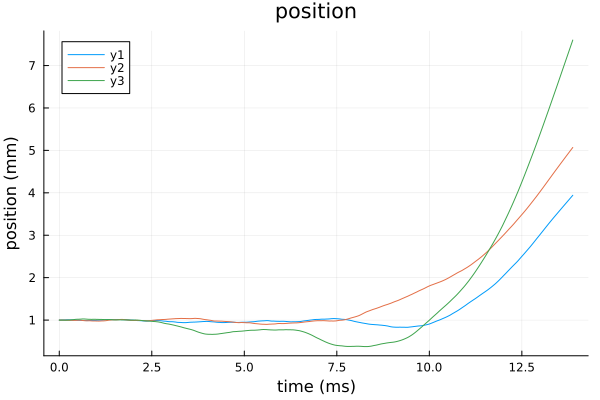

In [188]:
plot_ts = sol.t
plot_us = sol.u

plot()
for i in n_states + length(excited_states) +1 :n_states + length(excited_states) + 3
    plot!(plot_ts/Γ*1e3, [real(u[i]) for u in plot_us]./k*1e3)
end
plot!(legend=true, title="position", xlabel="time (ms)",ylabel="position (mm)")

Final temperature = 3.32e-02 K

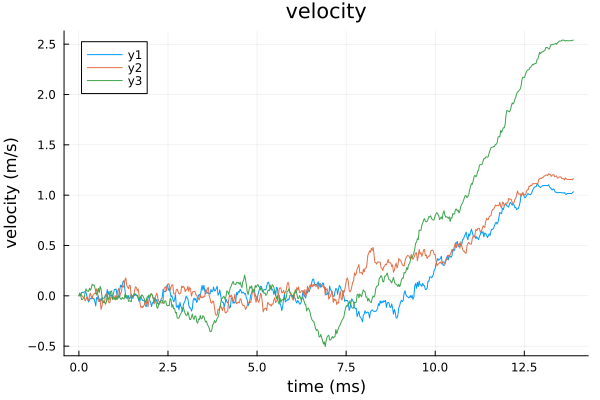

In [190]:
plot()
for i in n_states + length(excited_states) + 4:n_states + length(excited_states) + 6
    plot!(plot_ts/Γ*1e3, [real(u[i]) for u in plot_us]./k*Γ)
end
sol_vz = [real(u[n_states + length(excited_states) + 6]) for u in sol.u].*(Γ/k)
v2 = mean(sol_vz[end-length(sol_vz)÷6:end].^2)
k_B = 1.381e-23
@printf("Final temperature = %.2e K", m*v2/k_B)
plot!(legend=true, title="velocity", xlabel="time (ms)",ylabel="velocity (m/s)")

In [191]:
p.n_scatters

7781

In [192]:
println("Scattering rate:")
p.n_scatters / (sol.t[end] / Γ)

Scattering rate:


560739.3820807381

In [193]:
# using BenchmarkTools
# @btime ψ_stochastic!(p.ψ, p.ψ, p, 1.0)

In [194]:
# # `update_H` is passed to the simulation and can be used to add terms to the Hamiltonian that are time-dependent
# # Here we use `update_H` to include a quadrupole magnetic field for molecules in a magneto-optical trap
# function update_H(H_re, H_im, p, r, τ)
#     Zeeman_Hz = p.extra_p.Zeeman_Hz
#     Zeeman_Hx = p.extra_p.Zeeman_Hx
#     Zeeman_Hy = p.extra_p.Zeeman_Hy
    
#     # ramp the magnetic field
#     τ_bfield = p.extra_p.ramp_time / (1/Γ)
#     denom = 1/(exp(1)-1)
#     scalar = denom * exp(τ/τ_bfield) - denom
#     scalar = min(scalar, 1.0)
    
#     gradient_z = scalar * p.extra_p.gradient_z
#     gradient_x = scalar * p.extra_p.gradient_x
#     gradient_y = scalar * p.extra_p.gradient_y
#     @turbo for i in eachindex(H_re)
#         H_re[i] = gradient_z * Zeeman_Hz.re[i] * r[3] + gradient_x * Zeeman_Hx.re[i] * r[1] + gradient_y * Zeeman_Hy.re[i] * r[2]
#         H_im[i] = gradient_z * Zeeman_Hz.im[i] * r[3] + gradient_x * Zeeman_Hx.im[i] * r[1] + gradient_y * Zeeman_Hy.im[i] * r[2]
#     end
#     return nothing
# end
# ;

In [195]:
# # t_span = (0, 10e-3) ./ (1/Γ)

# # lasers = initialize_lasers()

# # n_excited=length(excited_states)

# # p = schrodinger_stochastic_nocomplex(particle, states, lasers, d, ψ₀, m/(ħ*k^2/Γ), n_excited; extra_p=extra_p, λ=λ, Γ=Γ, update_H=update_H)
# # p.ψ[2n_states + n_excited + 1] = 0.6e-3 / (1/k)
# # p.ψ[2n_states + n_excited + 2] = 0.6e-3 / (1/k)
# # p.ψ[2n_states + n_excited + 3] = 0.6e-3 / (1/k)

# # cb = ContinuousCallback(condition_nocomplex, SE_collapse_pol_always_nocomplex!, nothing, save_positions=(false,false))
# # prob = ODEProblem(ψ_stochastic_nocomplex!, p.ψ, t_span, p)
# # ;

# t_span = (0, 1e-3) ./ (1/Γ)

# lasers = initialize_lasers(states)

# n_excited=length(excited_states)

# p = schrodinger_stochastic_nocomplex_v0(particle, states, lasers, d, ψ₀, m/(ħ*k^2/Γ), n_excited; extra_p=extra_p, λ=λ, Γ=Γ, update_H=update_H)
# p.ψ[2n_states + n_excited + 1] = 0.6e-3 / (1/k)
# p.ψ[2n_states + n_excited + 2] = 0.6e-3 / (1/k)
# p.ψ[2n_states + n_excited + 3] = 0.6e-3 / (1/k)

# cb = ContinuousCallback(condition_nocomplex, SE_collapse_pol_always_nocomplex!, nothing, save_positions=(false,false))
# prob = ODEProblem(ψ_stochastic_nocomplex_v0!, p.ψ, t_span, p)
# ;

In [196]:
# using Logging: global_logger
# using TerminalLoggers: TerminalLogger
# global_logger(TerminalLogger())

# @time sol = DifferentialEquations.solve(prob, DP5(), reltol=1e-3, abstol=1e-8, callback=cb, saveat=100, maxiters=5000000, progress=true, progress_steps=200000);

In [197]:
# plot_ts = sol.t
# plot_us = sol.u

# plot()
# for i ∈ (2n_states + length(excited_states) + 1):(2n_states + length(excited_states) + 3)
#     plot!(plot_ts/Γ*1e3, [real(u[i]) for u in plot_us]./k*1e3)
# end
# plot!(legend=true, title="position", xlabel="time (ms)",ylabel="position (mm)")

In [198]:
# plot()
# for i in (2n_states + length(excited_states) + 4):(2n_states + length(excited_states) + 6)
#     plot!(plot_ts/Γ*1e3, [real(u[i]) for u in plot_us]./k*Γ)
# end
# sol_vz = [real(u[2n_states + length(excited_states) + 6]) for u in sol.u].*(Γ/k);
# v2 = mean(sol_vz[end-length(sol_vz)÷2:end].^2)
# k_B = 1.381e-23
# @printf("Final temperature = %.2e K", m*v2/k_B)
# plot!(legend=true, title="velocity", xlabel="time (ms)",ylabel="velocity (m/s)")

In [199]:
# p.n_scatters

In [200]:
# println("Scattering rate:")
# p.n_scatters / (sol.t[end] / Γ)

In [201]:
# using BenchmarkTools

In [202]:
# @btime ψ_stochastic_nocomplex!(p.ψ, p.ψ, p, 1.0)

# Propagating multiple particles

In [203]:
n_values = 40
n_threads=Threads.nthreads()
batch_size = fld(n_values, n_threads)
remainder = n_values - batch_size * n_threads
prog_bar = Progress(n_values)

x_trajectories = Array{Vector{Float64}}(undef, n_values) 
y_trajectories = Array{Vector{Float64}}(undef, n_values) 
z_trajectories = Array{Vector{Float64}}(undef, n_values) 
x_velocities = Array{Vector{Float64}}(undef, n_values) 
y_velocities = Array{Vector{Float64}}(undef, n_values) 
z_velocities = Array{Vector{Float64}}(undef, n_values) 
A_populations = Array{Vector{Float64}}(undef, n_values) 
times = Array{Vector{Float64}}(undef, n_values) 

ψ₀ = zeros(ComplexF64, length(states))
ψ₀[1] = 1.0

n_excited=length(excited_states)
n_states = length(states)

temp = @with_unit 0.2 "mK"
diameter = @with_unit 1.0 "mm"
displacement = @with_unit 0.6 "mm"
kick = 0.0 # m/s

y_dist, vy_dist = init_MOT_distribution(temp, diameter, displacement, 0)
z_dist, vz_dist = init_MOT_distribution(temp, diameter, 0, 0)
x_dist, vx_dist = init_MOT_distribution(temp, diameter, 0, 0)

Threads.@threads for i ∈ 1:n_threads
    
    _batch_size = i <= remainder ? (batch_size + 1) : batch_size
    batch_start_idx = 1 + (i <= remainder ? (i - 1) : remainder) + batch_size * (i-1)
    
    for j ∈ batch_start_idx:(batch_start_idx + _batch_size - 1)
        
        particle = OpticalBlochEquations.Particle()
        lasers = initialize_lasers(states)
        extra_p_copy = deepcopy(extra_p)
        
        p = schrodinger_stochastic_repump(particle, states, lasers, d, ψ₀, m/(ħ*k^2/Γ), n_excited;
            extra_p=extra_p, λ=λ, Γ=Γ, update_H=update_H, dark_lifetime=dark_lifetime, FC_mainline=FC_mainline)
        
        prob_copy = ODEProblem(ψ_stochastic_repump!, p.ψ, t_span, p)
        cb_copy = ContinuousCallback(condition_repump, SE_collapse_repump!, nothing, save_positions=(false,false))
        
        randomize_initial_vector!(prob_copy.p, x_dist, y_dist, z_dist, vx_dist, vy_dist, vz_dist)
        # fixed_initial_vector!(prob_copy.p, 0.6e-3, 0.6e-3, 0.6e-3, 0, 0, 0)
        random_initial_state!(prob_copy.p)
        
        sol = DifferentialEquations.solve(prob_copy, alg=DP5(), reltol=1e-3, callback=cb_copy, saveat=1000, maxiters=10000000)
        
        x_trajectories[j] =  [real(u[n_states + length(excited_states) + 1]) for u in sol.u]./k*1e3
        y_trajectories[j] = [real(u[n_states + length(excited_states) + 2]) for u in sol.u]./k*1e3
        z_trajectories[j] = [real(u[n_states + length(excited_states) + 3]) for u in sol.u]./k*1e3
        x_velocities[j] = [real(u[n_states + length(excited_states) + 4]) for u in sol.u]./k*Γ
        y_velocities[j] = [real(u[n_states + length(excited_states) + 5]) for u in sol.u]./k*Γ
        z_velocities[j] = [real(u[n_states + length(excited_states) + 6]) for u in sol.u]./k*Γ
        times[j] = sol.t./Γ*1e3
        A_populations[j] = [sum(real.(norm.(u[n_states - n_excited + 1 : n_states]).^2)) for u in sol.u]

        next!(prog_bar)
    end
end

Progress: 100%|█████████████████████████████████████████| Time: 0:03:19


In [209]:
function survived(t_end, times, trajectories)
    _survived = Int64[]
    for i ∈ eachindex(trajectories)
        if times[i][end] * 1e-3 ≈ t_end
            push!(_survived, i)
        end
    end
    return _survived
end

function cloud_size(trajectories, i)
    std(trajectory[i] for trajectory ∈ trajectories)
end

"""
    Evaluates the density given a set of trajectories.
"""
function density(t_end, times, x_trajectories, y_trajectories, z_trajectories)
    _survived = survived(t_end, times, x_trajectories)
    surviving_x_trajectories = x_trajectories[_survived]
    surviving_y_trajectories = y_trajectories[_survived]
    surviving_z_trajectories = z_trajectories[_survived]
    
    n = length(_survived)
    _density = Float64(n)
    if n > 0
        idx_end = length(surviving_x_trajectories[1])
        σ_x = cloud_size(surviving_x_trajectories, idx_end)
        σ_y = cloud_size(surviving_y_trajectories, idx_end)
        σ_z = cloud_size(surviving_z_trajectories, idx_end)
        println(σ_x)
        println(σ_y)
        println(σ_z)
        _density /= σ_x * σ_y * σ_z
    end
    return _density
end

@time density(30e-3, times, x_trajectories, y_trajectories, z_trajectories)

  0.054823 seconds (33.72 k allocations: 2.271 MiB, 99.94% compilation time)


0.0

## Trajectories

In [210]:
trapped_indicies = []
for j in eachindex(y_trajectories)
    if sqrt(x_trajectories[j][end]^2 + y_trajectories[j][end]^2 + z_trajectories[j][end]^2) <= 6 #mm
       push!(trapped_indicies, j)
    end
end

max_idx = maximum([length(time) for time ∈ times])

@printf("Number molecules trapped: %i out of %i", length(trapped_indicies), n_values)

Number molecules trapped: 25 out of 40

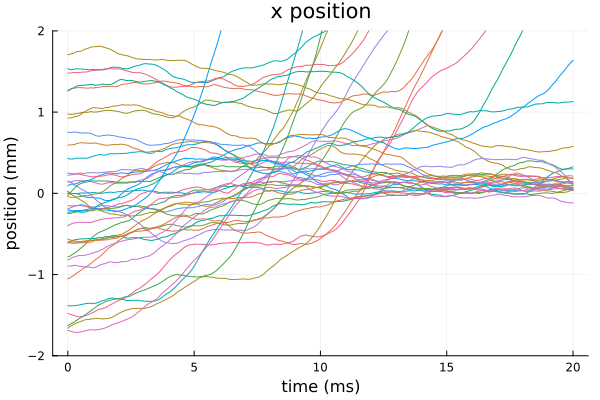

In [211]:
plot(legend=false, title="x position", xlabel="time (ms)",ylabel="position (mm)")
for j in 1:length(x_trajectories)
   plot!(times[j], x_trajectories[j])
end
plot!(ylim=(-2.0, 2.0))

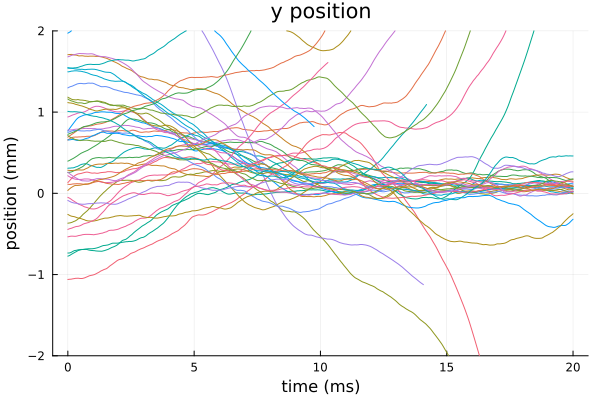

In [212]:
plot(legend=false, title="y position", xlabel="time (ms)",ylabel="position (mm)")
for j in 1:length(y_trajectories)
   plot!(times[j], y_trajectories[j])
end
plot!(ylim=(-2.0, 2.0))

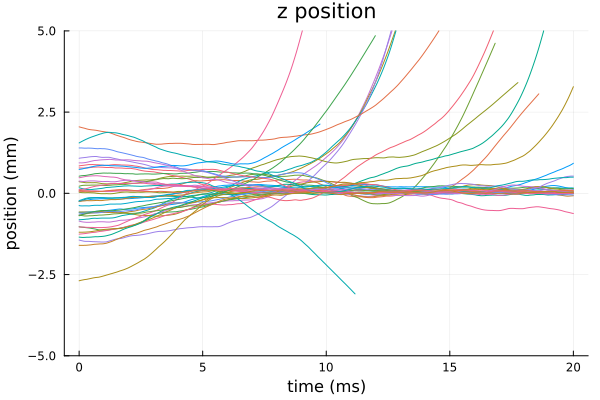

In [213]:
plot(legend=false, title="z position", xlabel="time (ms)",ylabel="position (mm)")
for j in 1:length(z_trajectories)
   plot!(times[j], z_trajectories[j])
end
plot!(ylim=(-5.0, 5.0))

## Plot density as a function of time

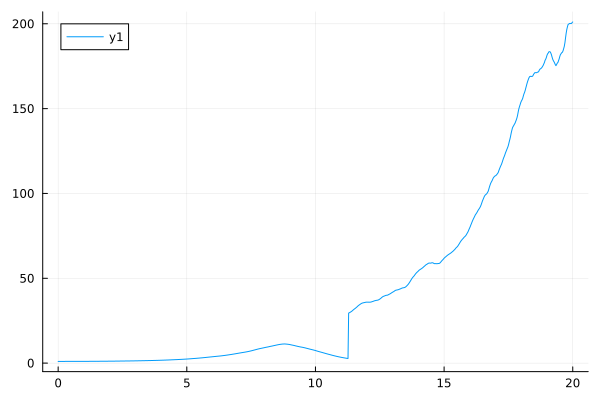

In [178]:
function survived(idx, times, trajectories)
    _survived = Int64[]
    for i ∈ eachindex(trajectories)
        if length(times[i]) >= idx
            push!(_survived, i)
        end
    end
    return _survived
end

function cloud_size_std(trajectories, i)
    std(trajectory[i] for trajectory ∈ trajectories)
end

function density(idx, times, x_trajectories, y_trajectories, z_trajectories)
    _survived = survived(idx, times, x_trajectories)
    surviving_x_trajectories = x_trajectories[_survived]
    surviving_y_trajectories = y_trajectories[_survived]
    surviving_z_trajectories = z_trajectories[_survived]
    
    n = length(_survived)
    _density = Float64(n)
    if n > 0
        σ_x = cloud_size_std(surviving_x_trajectories, idx)
        σ_y = cloud_size_std(surviving_y_trajectories, idx)
        σ_z = cloud_size_std(surviving_z_trajectories, idx)
        _density /= σ_x * σ_y * σ_z
    end
    return _density
end

plot(times[1], [exp(-500*times[1][i]/14000)*density(i, times, x_trajectories, y_trajectories, z_trajectories) for i ∈ eachindex(times[1])] ./ density(1, times, x_trajectories, y_trajectories, z_trajectories))

## Plot size of cloud

In [179]:
using LsqFit

function Gaussian(x, p)
    σ, x0, A = p
   return A * exp.(-(x.-x0).^2/(2*σ^2)) 
end

function cloud_size(i, trajectories)
    
    xs = [trajectory[i] for trajectory ∈ trajectories]

    hist_data = fit(Histogram, xs, nbins=5)
    hist_data.isdensity = true
    v = collect(hist_data.edges[1])
    dv = v[2]-v[1]
    v = v[1:end-1] .+ dv/2
    fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

    v_fit = curve_fit(Gaussian, v, fv, [0.5, 0., 10])
    σ, x0, A = v_fit.param

    return σ
end

cloud_size (generic function with 1 method)

In [180]:
_survived = survived(length(times[1]), times, x_trajectories)
surviving_x_trajectories = x_trajectories[trapped_indicies]#[_survived]
surviving_y_trajectories = y_trajectories[trapped_indicies]#[_survived]
surviving_z_trajectories = z_trajectories[trapped_indicies]#[_survived]
;

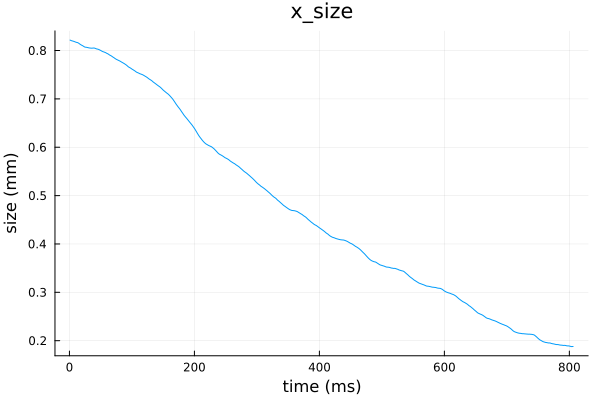

In [181]:
plot(legend=false, title="x_size", xlabel="time (ms)",ylabel="size (mm)")
σ_x = Float64[]

for i in 1:max_idx
    push!(σ_x, cloud_size_std(surviving_x_trajectories, i))
    # push!(σ_x, cloud_size(i, surviving_x_trajectories))
end
plot!(σ_x) 

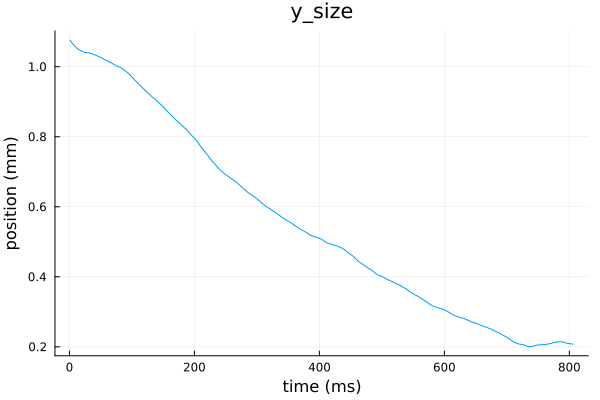

In [182]:
plot(legend=false, title="y_size", xlabel="time (ms)",ylabel="position (mm)")
σ_y = Float64[]

for i in 1:max_idx
   push!(σ_y, cloud_size_std(surviving_y_trajectories, i))
end
plot!(σ_y)

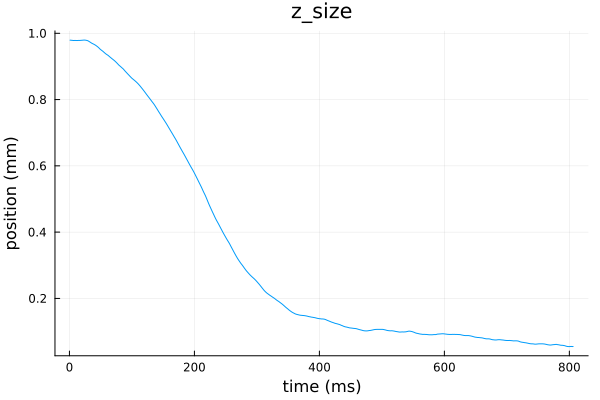

In [183]:
plot(legend=false, title="z_size", xlabel="time (ms)",ylabel="position (mm)")
σ_z = Float64[]

for i in 1:max_idx
   push!(σ_z, cloud_size_std(surviving_z_trajectories, i))
end
plot!(σ_z)

Final temperature = 2.32e-04 K

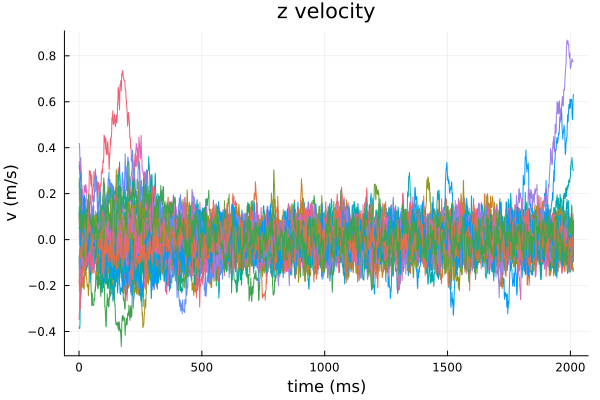

In [7021]:
plot(legend=false, title="z velocity", xlabel="time (ms)",ylabel="v (m/s)")
v_end = Float64[]
for j in trapped_indicies
   plot!(z_velocities[j]) 
    push!(v_end, z_velocities[j][end])

end

v2 = std(v_end)^2

k_B = 1.381e-23
@printf("Final temperature = %.2e K", m*v2/k_B)
plot!()

Final temperature = 6.43e-04 K

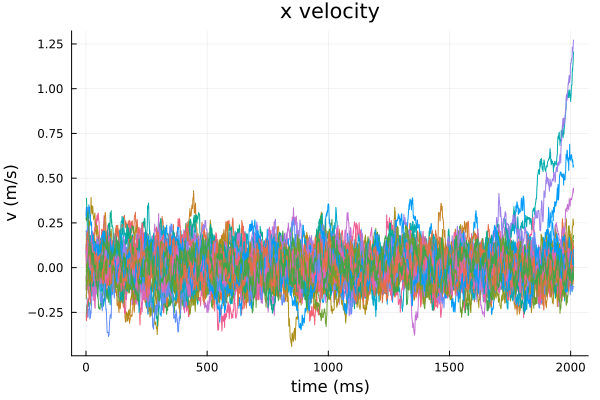

In [7022]:
plot(legend=false, title="x velocity", xlabel="time (ms)",ylabel="v (m/s)")
v_end = Float64[]
for j in trapped_indicies
   plot!(x_velocities[j]) 
    push!(v_end, x_velocities[j][end])
end

v2 = std(v_end)^2

k_B = 1.381e-23
@printf("Final temperature = %.2e K", m*v2/k_B)
plot!()

Final temperature = 3.55e-04 K

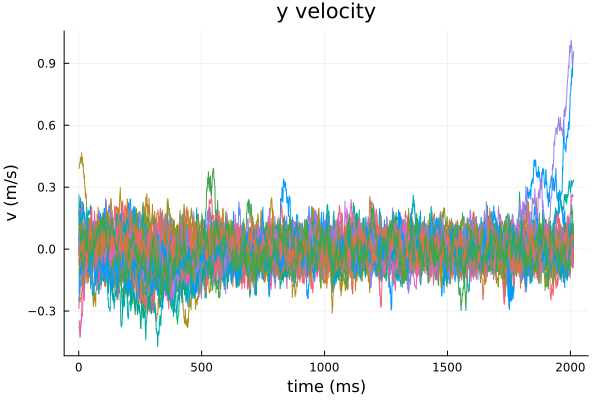

In [7023]:
plot(legend=false, title="y velocity", xlabel="time (ms)",ylabel="v (m/s)")
v_end = Float64[]
for j in trapped_indicies
   plot!(y_velocities[j]) 
    push!(v_end, y_velocities[j][end])
end

v2 = std(v_end)^2

k_B = 1.381e-23
@printf("Final temperature = %.2e K", m*v2/k_B)
plot!()

In [6076]:
function scattering_rate(populations, i)
    _scattering_rate = 0.0
    counts = 0
    for j ∈ 1:n_values
        if length(populations[j]) >= i
            _scattering_rate += populations[j][i] * Γ
            counts += 1
        end
    end
    return _scattering_rate / counts
end;

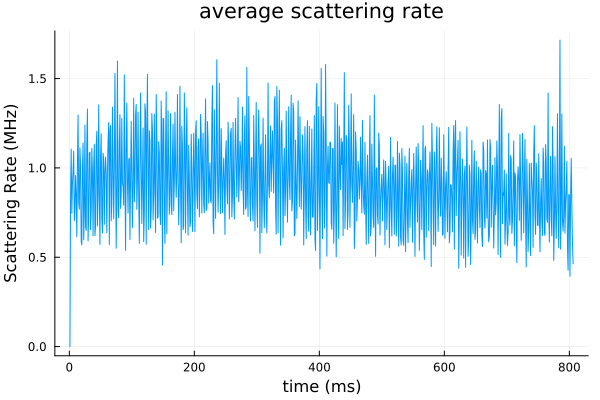

In [6077]:
plot(legend=false, title="average scattering rate", xlabel="time (ms)",ylabel="Scattering Rate (MHz)")
avg_scattering = Float64[]

for i in 1:max_idx
   push!(avg_scattering, scattering_rate(A_populations, i))
end
plot!(1:max_idx, avg_scattering * 1e-6)

In [6078]:
mean(avg_scattering)

921126.8993779903

In [5783]:
plot(legend=false, title="velocity", xlabel="time (ms)",ylabel="temperature (μK)")
σ_v = []
for i in 1:1000
   push!(σ_v, std([v[i] for v in x_velocities]))
end
plot!(times[1][1:1000], m*σ_v.^2/k_B*1e6)

LoadError: BoundsError: attempt to access 806-element Vector{Float64} at index [807]

In [5784]:
equilibrium_velocities = zeros(Float64,0)
for v_particle in z_velocities
   equilibrium_velocities = [equilibrium_velocities; v_particle[end - length(times[1])÷2: end]] 
end

v2 = std(equilibrium_velocities)^2

k_B = 1.381e-23
@printf("Final temperature = %.2e K", m*v2/k_B)
;

Final temperature = 5.10e-05 K

Final temperature = 5.27e-05 K

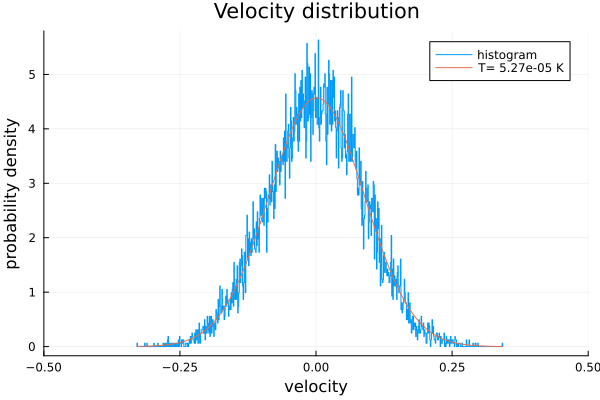

In [5785]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="Velocity distribution")
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=1000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=1000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

Final temperature = 5.27e-05 K

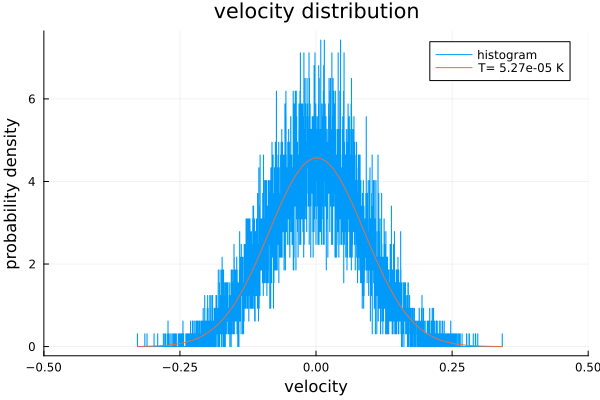

In [5786]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution")
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=4000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=4000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

Final temperature = 7.03e-05 K

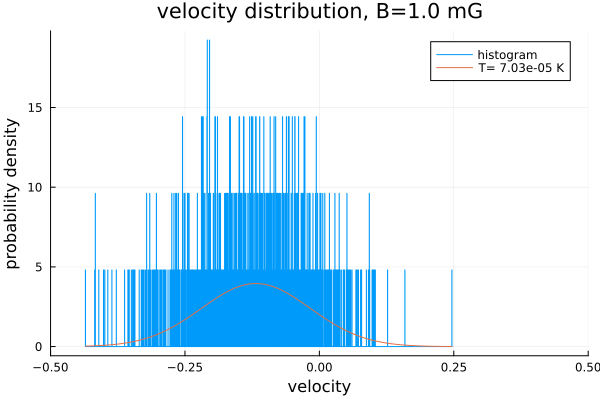

In [317]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution, B=1.0 mG", xlim=[-1,1])
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=4000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=4000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

Final temperature = 7.03e-05 K

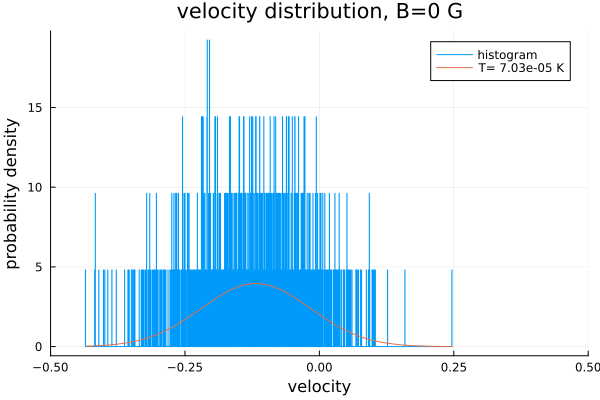

In [318]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution, B=0 G")
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=4000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=4000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

Final temperature = 7.03e-05 K

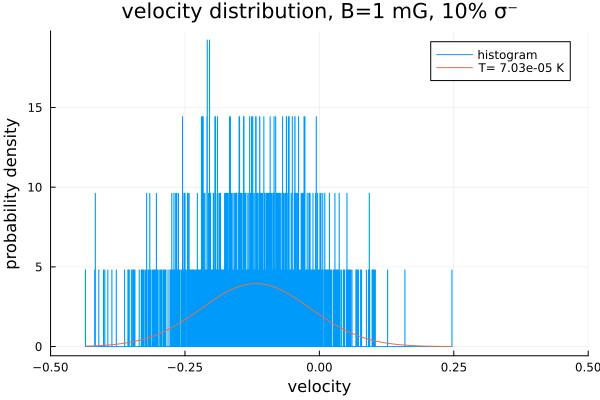

In [319]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution, B=1 mG, 10% σ⁻")
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=4000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=4000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

Final temperature = 7.03e-05 K

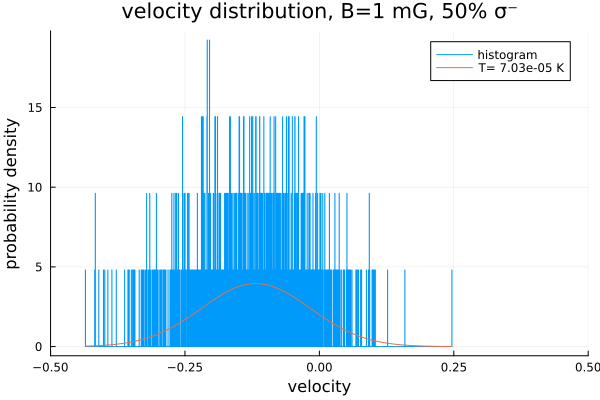

In [320]:
plot(legend=true, xlabel="velocity", ylabel="probability density", title="velocity distribution, B=1 mG, 50% σ⁻")
v2 = std(equilibrium_velocities)^2


x = stephist!(equilibrium_velocities, normalize=:pdf, label="histogram", nbins=4000)

hist_data = fit(Histogram, equilibrium_velocities, nbins=4000)
hist_data.isdensity = true
v = collect(hist_data.edges[1])
dv = v[2]-v[1]
v = v[1:end-1] .+ dv/2
fv = hist_data.weights ./ (sum(hist_data.weights) * dv)

v_fit = curve_fit(Gaussian, v, fv, [0.01, 0, 50])
σ, x0, A = v_fit.param

k_B = 1.381e-23
fit_T = m*σ^2/k_B
@printf("Final temperature = %.2e K", fit_T)

plot!(v, Gaussian(v, v_fit.param), label=@sprintf("T= %.2e K", fit_T))
plot!(xlim=(-0.5,0.5))

# Comparison to Monte Carlo simulations with OBE

  4.025756 seconds (6.19 M allocations: 718.537 MiB, 1.67% gc time, 85.57% compilation time)


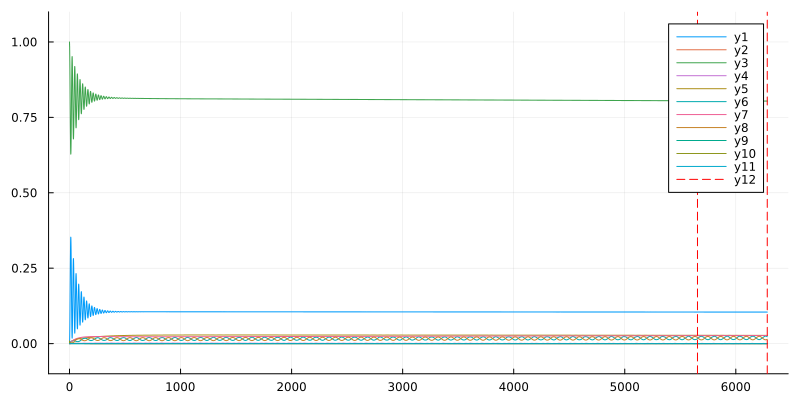

In [172]:
particle = Particle()
ρ0 = zeros(ComplexF64, length(H.states), length(H.states))
ρ0[3,3] = 1.0
freq_res = 1e-2

p = obe(ρ0, particle, H.states, lasers, d, d, true, true, λ, Γ, freq_res, nothing)

t_end = 10p.period
tspan = (0., t_end)
prob = ODEProblem(ρ!, p.ρ0_vec, tspan, p)
callback = PeriodicCallback(reset_force!, prob.p.period)

prob.p.r0 = (0., 0., 0.4) .* 2π
prob.p.v = (0., 0., 0.0)
@time sol = DifferentialEquations.solve(prob, alg=DP5(), reltol=1e-5, abstol = 1e-5, callback=callback)
prob.p.force_last_period .* (ħ * k * Γ / m)*1e-3

using Plots
plot_us = sol.u#[1:10:end]
plot_ts = sol.t#[1:10:end]

n_states = size(p.ρ_soa, 1)
plot(size=(800, 400), ylim=(-0.1, 1.1), legend=nothing)
for i in 1:n_states
    state_idx = n_states*(i-1) + i
    plot!(plot_ts, [real(u[state_idx]) for u in plot_us])
end
plot!(legend=true)
offset = 0
vline!([sol.t[end] - prob.p.period - offset, sol.t[end] - offset], color="red", linestyle=:dash)

In [29]:


function prob_func!(prob, scan_params, i)
    p = prob.p
    
    # Update velocity and position
    p.particle.v .= scan_params[i].v
    p.particle.r0 .= scan_params[i].r
    
    
    # Update magnetic field
    H = p.extra_p.H
    H.parameters.B_z = scan_params[i].B
    evaluate!(H)
    QuantumStates.solve!(H)
    
    # Update transition dipole moments
    update_basis_tdms!(H)
    update_tdms!(H)
    new_d = H.tdms
    
    s = p.extra_p.s
    ω1 = p.extra_p.ω1
    
    k̂ = +x̂; ϵ1 = exp(im*scan_params[i].θx) *rotate_pol(σ⁺, k̂); ϵ_func1 = ϵ_(ϵ1); laser1 = Field(k̂, ϵ_func1, ω1, s)
    k̂ = -x̂; ϵ2 = exp(im*scan_params[i].θx) *rotate_pol(σ⁺, k̂); ϵ_func2 = ϵ_(ϵ2); laser2 = Field(k̂, ϵ_func2, ω1, s)

    k̂ = +ŷ; ϵ3 = exp(im*scan_params[i].θy) * rotate_pol(σ⁺, k̂); ϵ_func3 = ϵ_(ϵ3); laser3 = Field(k̂, ϵ_func3, ω1, s)
    k̂ = -ŷ; ϵ4 = exp(im*scan_params[i].θy) *rotate_pol(σ⁺, k̂); ϵ_func4 = ϵ_(ϵ4); laser4 = Field(k̂, ϵ_func4, ω1, s)

    k̂ = +ẑ; ϵ5 = rotate_pol(σ⁺, k̂);  ϵ_func5 = ϵ_(ϵ5); laser5 = Field(k̂, ϵ_func5, ω1, s)
    k̂ = -ẑ; ϵ6 = rotate_pol(σ⁺, k̂);  ϵ_func6 = ϵ_(ϵ6); laser6 = Field(k̂, ϵ_func6, ω1, s)

    lasers = [laser1, laser2, laser3, laser4, laser5, laser6]
    new_p = obe(p.ρ0, p.particle, H.states, lasers, new_d, nothing, true, true, p.λ, p.Γ, p.freq_res, p.extra_p)
    
    
    return remake(prob, p=new_p)
end

function output_func(p, sol)
    f = p.force_last_period
    return f
end
;

In [584]:
ρ0 = zeros(ComplexF64, length(H.states), length(H.states))
ρ0[3,3] = 1.0

t_end = 10p.period
tspan = (0., t_end)

using RectiGrids

freq_res = 1e-2
extra_p = (H=H, lasers=lasers, ω1 = ω1, s = s)
p = obe(ρ0, particle, H.states, lasers, d, d, true, true, λ, Γ, freq_res, extra_p)

t_end = 10p.period+1; tspan = (0., t_end)
prob = ODEProblem(ρ!, p.ρ0_vec, tspan, p, reltol=1e-3, save_on=false)

di = 5
rs = vcat([(n1*λ/(di+1), n2*λ/(di+1), n3*λ/(di+1)) .* 2π for n1 ∈ 0:di, n2 ∈ 0:di, n3 ∈ 0:di]...)
vzs = LinRange(0,15/(Γ/k),100)
vs = []
for vz in vzs
    push!(vs, [0,0,vz])
end

# vs = [sample_direction(0.0) for _ in 1:1]


scan_values = (B = [0.0], r = rs, v = vs, θx = [0.0], θy = [0.0])
scan_values_grid = RectiGrids.grid(scan_values)

@time forces, populations = force_scan_v2(prob, scan_values_grid, prob_func!, output_func);

averaged_forces = []
averaged_A_populations = []
@time for (i,vz) ∈ enumerate(vzs)
    idxs = [j for (j,x) ∈ enumerate(scan_values_grid) if x.v[3] == vz]
    push!(averaged_forces, mean([f[3] for f in forces[idxs]]))
    push!(averaged_A_populations, mean(populations[idxs, 4:6])*3)
end

LoadError: UndefVarError: `H` not defined

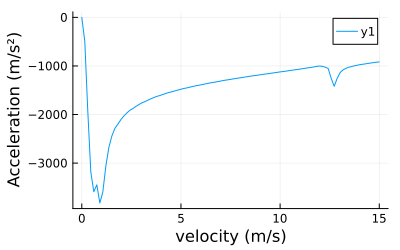

In [175]:
plot(xlabel="velocity (m/s)", ylabel="Acceleration (m/s²)",size=(400,250))
plot!(vzs.*(Γ/k), averaged_forces.* (ħ * k * Γ / m))

In [176]:
# plot(vzs.*(Γ/k), averaged_A_populations,size=(400,250))

In [177]:
include("G:\\My Drive\\github\\BlueDetunedMOTSimulations\\CaOH_simulation_toolbox.jl");
using Interpolations, BeamPropagation
;

In [178]:
scan_values = Dict{String, Vector{Float64}}("B"=>[-1000,1000], "v"=>vzs)
acceleration = zeros(2,length(averaged_forces))
A_populations = zeros(2,length(averaged_forces))

acceleration[1,:] = acceleration[2,:] = averaged_forces.*(ħ * k * Γ / m)
A_populations[1,:] = A_populations[2,:] = averaged_A_populations

acceleration_grids = make_grids(scan_values, acceleration)
A_population_grids = make_grids(scan_values, A_populations)



# Interpolate (in SI units)
B_range = range(scan_values["B"][1],scan_values["B"][end], length=length(scan_values["B"]))
v_range = range(scan_values["v"][1]* (Γ / k),scan_values["v"][end]* (Γ / k), length=length(scan_values["v"]))
        

nodes = (scan_values["B"], scan_values["v"].* (Γ / k))
acceleration_func = interpolate(nodes, acceleration_grids, Gridded(Linear()))
A_population_func = interpolate(nodes, A_population_grids, Gridded(Linear()))     
A_population_func = extrapolate(A_population_func, Flat());


["B", "v"]
["B", "v"]


In [179]:
# y = scan_values["v"].* (Γ / k)
# B_fixed = 1
# plot(xlabel="velocity (m/s)", ylabel="Acceleration (m/s²)",size=(400,250))
# plot!(y, acceleration_func(-100,y) , label=@sprintf("B = %.1f G", B_fixed) )
# plot!()

In [57]:
function update(particles, p, s, dt, time, idx)
    hbar = 1.05457182e-34 
    for i in 1:size(particles, 1)
        B = particles.r[i][3] * p.B_gradient
        v = particles.v[i]
        Pe = p.A_population_func(B * sign(v[3]), abs(v[3]))
        scattering_prob = dt * Γ * Pe
        if rand() < scattering_prob 
            v_rand = sample_direction(hbar * k / m) * 1
            particles.v[i] += SVector(0,0,v_rand[3])
            # if rand() < 0.5
            #     particles.v[i] += sample_direction(hbar * k / m) # SVector(0,0,hbar * k / m)
            # else
            #     particles.v[i] -= SVector(0,0,hbar * k / m)
            # end
        end
    end
    return nothing
end

function init_1D_MOT_distribution(T, diameter)
    kB = 1.381e-23
    m = @with_unit 57 "u"
    σ = sqrt(kB * T / m)
    
    r = (Normal(0, diameter), Normal(0, diameter), Normal(0, diameter))
    v = (Normal(0, σ), Normal(0, σ), Normal(0, σ))
    a = (Normal(0, 0), Normal(0, 0), Normal(0, 0))
    return r, v, a
end

function init_isotropic_MOT_distribution(T, diameter)
    kB = 1.381e-23
    m = @with_unit 57 "u"
    σ = sqrt(kB * T / m)
    
    r = Normal(0, diameter)
    v = Normal(0, σ)
    return r, v
end


function discard_particles!(particles, discard)
    @inbounds for i in 1:size(particles, 1)
        particles.dead[i] = discard(particles.r[i], particles.v[i])
    end
    StructArrays.foreachfield(x -> deleteat!(x, particles.dead), particles)
    return nothing
end

function discard_out_of_bound(r, v)
    if abs(r[3]) > abs( maximum(scan_values["B"]) / B_gradient )
        return true
    elseif abs(v[3]) > abs( maximum(scan_values["v"])* (Γ / k))
        return true
    else
        return false
    end
end

discard_out_of_bound (generic function with 1 method)

In [181]:
import BeamPropagation.Particle
import StructArrays: StructArray, StructVector
using StructArrays

B_gradient = 0
n = 1000
save_every = 3000
delete_every = 100
dt_min = 1e-10
dt_max = 1e-4
abstol = 1e-5
dt = 1e-8
total_time = @with_unit 5 "ms"
max_steps = Int64(ceil(total_time / dt))
alg = "rkf12"
use_adaptive = false
dt0 = 1e-5
times = (0:dt:max_steps * dt)[1:save_every:end-1]


particles = StructArray{BeamPropagation.Particle}(undef, n)
trajectories = [SVector{3, Float64}[] for _ ∈ 1:length(particles)]
velocities = [SVector{3, Float64}[] for _ ∈ 1:length(particles)]
A_populations = [SVector{1, Float64}[] for _ ∈ 1:length(particles)]

temp = @with_unit 1 "mK"
diameter = @with_unit 0.6 "mm"
r, v, a = init_1D_MOT_distribution(temp, diameter)



p = MutableNamedTuple(B_gradient=B_gradient, acceleration_func=acceleration_func, A_population_func = A_population_func)
mc_s = MutableNamedTuple(trajectories=trajectories, velocities = velocities, A_populations = A_populations)

@time propagate_particles!(r, v, a, 
    alg, particles, f, save, discard_out_of_bound, save_every, delete_every, max_steps, update, p, mc_s, dt, use_adaptive, 
    dt_min, dt_max, abstol, true
)



Progress: 100%|█████████████████████████████████████████| Time: 0:00:0439mProgress:   0%|█                                        |  ETA: 30.02 days


  4.219141 seconds (42.01 M allocations: 726.699 MiB, 367.81% compilation time)


Final temperature = 9.05e-05 K

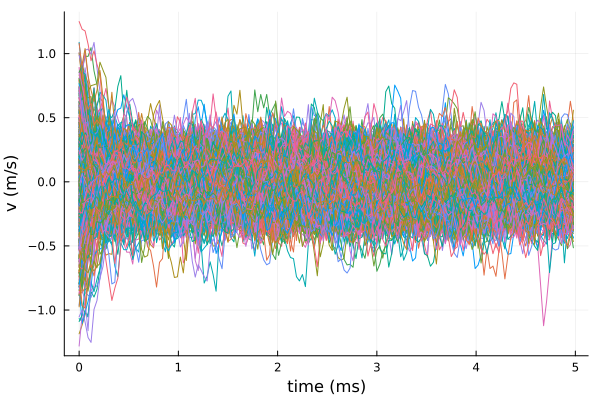

In [182]:
plot(xlabel="time (ms)", ylabel="v (m/s)", legend=false)
for particle_id in 1:1:n
    particle_z_velocity = [mc_s.velocities[particle_id][i][3] for i in  eachindex(mc_s.trajectories[particle_id])]
    plot!(times[1:length(particle_z_velocity)] * 1e3, particle_z_velocity)
end

vs = []
i_half = length(times)÷2
for particle_id in 1:1:n
    push!(vs, mc_s.velocities[particle_id][i_half][3])
end
v = std(vs)

k_B = 1.381e-23
@printf("Final temperature = %.2e K", 1/2*m*v^2/k_B)


plot!()

In [60]:
function add_B_to_A!(A::StructArray{<:Complex}, B::StructArray{<:Complex})
    @turbo for i ∈ eachindex(A)
        A.re[i] = A.re[i] + B.re[i]
        A.im[i] = A.im[i] + B.im[i]
    end
end

function add_B_to_A_with_scalar!(A::StructArray{<:Complex}, B::StructArray{<:Complex}, scalar::Float64)
    @turbo for i ∈ eachindex(A)
        A.re[i] = A.re[i] + scalar * B.re[i]
        A.im[i] = A.im[i] + scalar * B.im[i]
    end
end

add_B_to_A_with_scalar! (generic function with 1 method)

### Copies of some private functions from OpticalBlochEquations package

In [18]:
# Multiplication using `@turbo` from LoopVectorization
function mul_turbo!(C, A, B)
    @turbo for m ∈ 1:size(A,1), n ∈ 1:size(B,2)
        Cmn_re = 0.0
        Cmn_im = 0.0
        for k ∈ 1:size(A,2)
            A_mk_re = A.re[m,k]
            A_mk_im = A.im[m,k]
            B_kn_re = B.re[k,n]
            B_kn_im = B.im[k,n]
            Cmn_re += A_mk_re * B_kn_re - A_mk_im * B_kn_im
            Cmn_im += A_mk_re * B_kn_im + A_mk_im * B_kn_re
        end
        C.re[m,n] = Cmn_re
        C.im[m,n] = Cmn_im
    end
end

function mul_by_im!(C::StructArray{<:Complex})
    @turbo for i ∈ eachindex(C)
        a = C.re[i]
        C.re[i] = -C.im[i]
        C.im[i] = a
    end
end

function mul_by_im_minus!(C::StructArray{<:Complex})
    @turbo for i ∈ eachindex(C)
        a = C.re[i]
        C.re[i] = C.im[i]
        C.im[i] = -a
    end
end

function soa_to_base!(ρ::Array{<:Complex}, ρ_soa::StructArray{<:Complex})
    @inbounds for i in eachindex(ρ_soa)
        ρ[i] = ρ_soa.re[i] + im * ρ_soa.im[i]
    end
    return nothing
end

function base_to_soa!(ρ::Array{<:Complex}, ρ_soa::StructArray{<:Complex})
    @inbounds for i in eachindex(ρ_soa)
        ρ_soa.re[i] = real(ρ[i])
        ρ_soa.im[i] = imag(ρ[i])
    end
    return nothing
end

function base_to_soa_vec!(ρ::Array{<:Complex}, ρ_soa::StructArray{<:Complex})
    @inbounds for i in eachindex(ρ, ρ_soa)
        ρ_soa.re[i] = real(ρ[i])
        ρ_soa.im[i] = imag(ρ[i])
    end
    return nothing
end

function update_eiωt!(eiωt::StructArray{<:Complex}, ω::Array{<:Real}, τ::Real)
    @turbo for i ∈ eachindex(ω)
        eiωt.im[i], eiωt.re[i] = sincos( ω[i] * τ )
    end
    return nothing
end



update_eiωt! (generic function with 1 method)

In [25]:
import OpticalBlochEquations.update_H!

function update_H(H, p, τ)
    @turbo for i in eachindex(H)
        H.re[i] = p.H₀.re[i]
        H.im[i] = p.H₀.im[i]
    end
    return nothing
end

function update_H!(p, τ, r, H₀, fields, H, E_k, ds, ds_state1, ds_state2, Js)

    p.update_H(H, p, τ)
    
    # @turbo for i in eachindex(H)
    #     H.re[i] = H₀.re[i]
    #     H.im[i] = H₀.im[i]
    # end
 
    update_fields!(fields, r, τ)

    # Set summed fields to zero
    p.E -= p.E
    @inbounds for i ∈ 1:3
        E_k[i] -= E_k[i]
    end
    
    # Sum updated fields
    @inbounds for i ∈ eachindex(fields)
        E_i = fields.E[i] * sqrt(fields.s[i]) / (2 * √2)
        k_i = fields.k[i]
        p.E += E_i
        for k ∈ 1:3
            E_k[k] += E_i * k_i[k]
        end
    end

    # This can be used to exclude very off-resonant terms, need to add a user-defined setting to determine behavior
    # @inbounds for i ∈ eachindex(fields)
    #     s = fields.s[i]
    #     ω_field = fields.ω[i]
    #     x = sqrt(s) / (2 * √2)
    #     @inbounds for q ∈ 1:3
    #         E_i_q = fields.E[i][q]
    #         if norm(E_i_q) > 1e-10
    #             d_nnz_q = d_nnz[q]
    #             d_q = @view d[:,:,q]
    #             @inbounds @simd for cart_idx ∈ d_nnz_q
    #                 m, n = cart_idx.I
    #                 if abs(ω_field - (ω[n] - ω[m])) < 100 # Do not include very off-resonant terms (terms detuned by >10Γ)
    #                     val = x * E_i_q * d_q[m,n]
    #                     H[m,n] += val
    #                     H[n,m] += conj(val)
    #                 end
    #             end
    #         end
    #     end
    # end

    @inbounds for q ∈ 1:3
        E_q = p.E[q]
        if norm(E_q) > 1e-10
            E_q_re = real(E_q)
            E_q_im = imag(E_q)
            ds_q = ds[q]
            ds_q_re = ds_q.re
            ds_q_im = ds_q.im
            ds_state1_q = ds_state1[q]
            ds_state2_q = ds_state2[q]
            @turbo for i ∈ eachindex(ds_q)
                m = ds_state1_q[i] # excited state
                n = ds_state2_q[i] # ground state
                d_re = ds_q_re[i]
                d_im = ds_q_im[i]
                val_re = E_q_re * d_re - E_q_im * d_im
                val_im = E_q_re * d_im + E_q_im * d_re
                H.re[n,m] += val_re
                H.im[n,m] += val_im
                H.re[m,n] += val_re
                H.im[m,n] -= val_im
            end
        end
    end

    # Is this version faster?
    # @inbounds for q ∈ 1:3
    #     E_q = p.E[q]
    #     if norm(E_q) > 1e-10
    #         d_nnz_q = d_nnz[q]
    #         d_q = @view d[:,:,q]
    #         @inbounds @simd for cart_idx ∈ d_nnz_q
    #             m, n = cart_idx.I
    #             val = E_q * d_q[m,n]
    #             H[m,n] += val
    #             H[n,m] += conj(val)
    #         end
    #     end
    # end

    for J ∈ Js
        rate = im * J.r^2 / 2
        H[J.s, J.s] -= rate
    end

    return nothing
end

round_to_mult(val, prec) = round.(val ./ prec) .* prec

function round_freq(ω, freq_res)
    ω_min = freq_res
    return round_to_mult(ω, ω_min)
end
export round_freq



function round_v_by_norm(v, digits)
    v_norm = norm(v)
    return v ./ (v_norm / round(v_norm, digits=digits))
end

function round_freqs!(states, fields, freq_res)
    """
    Rounds frequencies of state energies and fields by a common denominator.
    
    freq_res::Float: all frequencies are rounded by this value (in units of Γ)
    """
    for i in eachindex(fields)
        fields.ω[i] = round_freq(fields.ω[i], freq_res)
    end
    for i in eachindex(states)
        states.E[i] = round_freq(states.E[i], freq_res)
    end
    return nothing
end


round_freqs! (generic function with 1 method)

In [202]:
F = 1
F′ = 1
J_mat = zeros(2F+1 + 2F′+1,2F+1 + 2F′+1)
for i in 1:2F+1
    M = -F-1+i
    for j in 2F+2:2F+1+2F′+ 1
        M′ = -F′-1+ (j - 2F - 1)
        for p in -1:1:1
            J_mat[i,j] += norm(wigner3j(F, 1, F′, M, -p, -M′))^2
        end
    end
end
J_mat

6×6 Matrix{Float64}:
 0.0  0.0  0.0  0.166667  0.166667  0.0
 0.0  0.0  0.0  0.166667  0.0       0.166667
 0.0  0.0  0.0  0.0       0.166667  0.166667
 0.0  0.0  0.0  0.0       0.0       0.0
 0.0  0.0  0.0  0.0       0.0       0.0
 0.0  0.0  0.0  0.0       0.0       0.0

In [207]:
Ux = [[1/2, -1/sqrt(2), 1/2],
    [-1/sqrt(2),0,1/sqrt(2)],
    [1/2, 1/sqrt(2), 1/2]]

Ux = mapreduce(permutedims, vcat, Ux)

U = zeros(2F+1 + 2F′+1,2F+1 + 2F′+1)

3×3 Matrix{Float64}:
  0.5       -0.707107  0.5
 -0.707107   0.0       0.707107
  0.5        0.707107  0.5